In [1]:
!nvidia-smi

Tue Feb  4 20:36:30 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 537.70                 Driver Version: 537.70       CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Quadro P6000                 WDDM  | 00000000:03:00.0  On |                 ERR! |
| 26%   49C    P8              15W / 250W |   1955MiB / 24576MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
import torch
%matplotlib inline

#device = 'cuda:0'
device = 'cuda:1'
device = device if torch.cuda.is_available() else 'cpu'
device

'cuda:1'

# 1. Create Datasets

In [3]:
train_folder_path = r'dfc25_track1_trainval\train'
val_folder_path = r'dfc25_track1_trainval\train'
test_folder_path = r'dfc25_track1_trainval\train'

In [4]:
import os
import numpy as np
from PIL import Image
from torch.utils.data import Dataset

class SegmentationDataset(Dataset):
    def __init__(self, folder_path, transforms=None):
        self.folder_path = folder_path
        self.transforms = transforms
        
        self.sar_folder_path = os.path.join(folder_path, 'sar_images')
        self.rgb_folder_path = os.path.join(folder_path, 'rgb_images')
        
        self.sar_files = sorted(os.listdir(self.sar_folder_path))
        self.rgb_files = sorted(os.listdir(self.rgb_folder_path))
        
        # Image cache
        self.image_cache = {}

    def __len__(self):
        return len(self.sar_files)
    
    def read_img(self, path):
        """Reads and caches an image."""
        if path not in self.image_cache:
            img = np.array(Image.open(path))
            self.image_cache[path] = img
        return self.image_cache[path]
    
    def __getitem__(self, idx):
        sar_path = os.path.join(self.sar_folder_path, self.sar_files[idx])
        rgb_path = os.path.join(self.rgb_folder_path, self.rgb_files[idx])
        
        sar = self.read_img(sar_path)[:, :, np.newaxis]  # Ensure channel dimension
        rgb = self.read_img(rgb_path)
        
        if self.transforms:
            sar_rgb = np.concatenate([sar, rgb], axis=2)
            results = self.transforms(image=sar_rgb)
            image = results['image']
            sar = image[:1, :, :]
            rgb = image[1:, :, :]
        
        return sar, rgb

In [5]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

mean = (0.19407524985160743,  # SAR
        0.4919135824150882, 0.5065469988267931, 0.4547521695503487) # RGB
std = (0.11998196523095886, # SAR
       0.15089740680957267, 0.12776688363324923, 0.12191884548626808) # RGB

# SAR channels should use original statistics, RGB should be scaled to [-1,1]
mean = (0.19407524985160743,  # Keep original SAR mean
        0.5, 0.5, 0.5)        # RGB means set to 0.5

std = (0.11998196523095886,   # Keep original SAR std
       0.5, 0.5, 0.5)         # RGB stds set to 0.5

size = (256, 256)
train_transforms = A.Compose([
    A.Resize(*size),
    A.Normalize(mean=mean, std=std),
    ToTensorV2()
])

val_transforms = A.Compose([
    A.Resize(*size),
    A.Normalize(mean=mean, std=std),
    ToTensorV2()
])

test_transforms = A.Compose([
    A.Resize(*size),
    A.Normalize(mean=mean, std=std),
    ToTensorV2()
])

def denormalize_sar(sar):
    return sar * std[0] + mean[0]

def denormalize_rgb(rgb):
    # shape: (3, 512, 512)
    return rgb * torch.tensor(std[1:]).view(3, 1, 1) + torch.tensor(mean[1:]).view(3, 1, 1)

C:\Users\U-III\.conda\envs\torch_env\lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: '[WinError 127] The specified procedure could not be found'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [6]:
train_dataset = SegmentationDataset(train_folder_path, transforms=train_transforms)
len(train_dataset)

4333

In [7]:
a, b = train_dataset[17]
a.shape, b.shape, a.mean(dim=(1, 2)), b.mean(dim=(1, 2)), a.std(dim=(1, 2)), b.std(dim=(1, 2)), b.min(), b.max()

(torch.Size([1, 256, 256]),
 torch.Size([3, 256, 256]),
 tensor([-0.1128]),
 tensor([ 0.3300,  0.1523, -0.0565]),
 tensor([0.7179]),
 tensor([0.1022, 0.1183, 0.1125]),
 tensor(-0.3098),
 tensor(0.7098))

# 1.1. Visualize Dataset

In [8]:
import matplotlib.pyplot as plt

def plot_image_and_mask(sar, rgb):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    sar_norm = denormalize_sar(sar).squeeze()
    rgb_norm = denormalize_rgb(rgb).permute(1, 2, 0)
    ax[0].imshow(sar_norm, cmap='gray')
    ax[1].imshow(rgb_norm)
    ax[0].axis('off')
    ax[1].axis('off')
    plt.show()

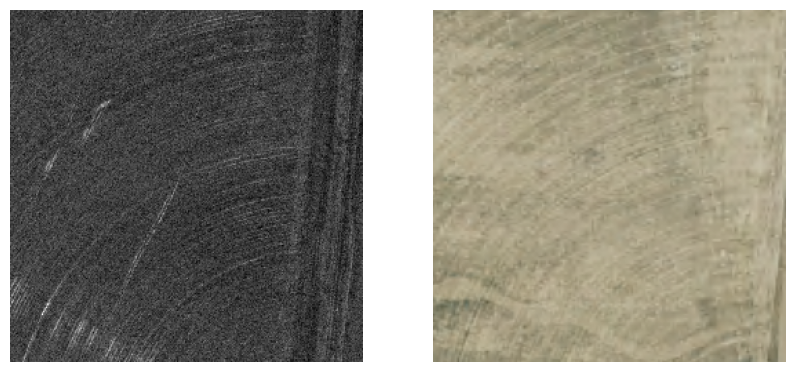

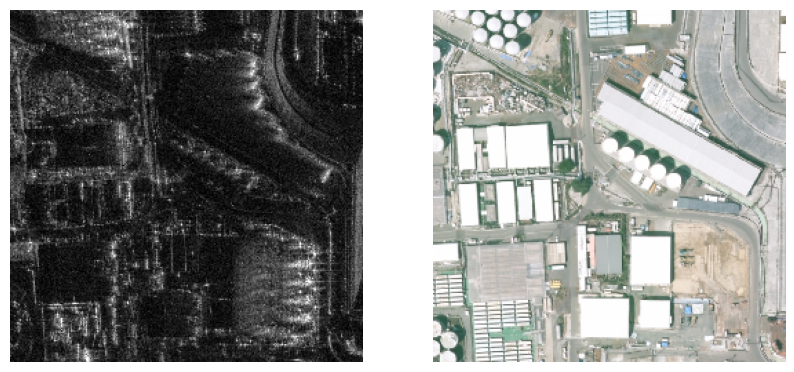

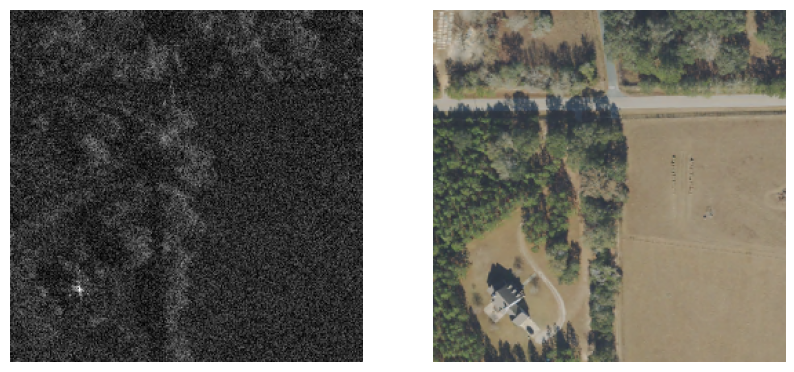

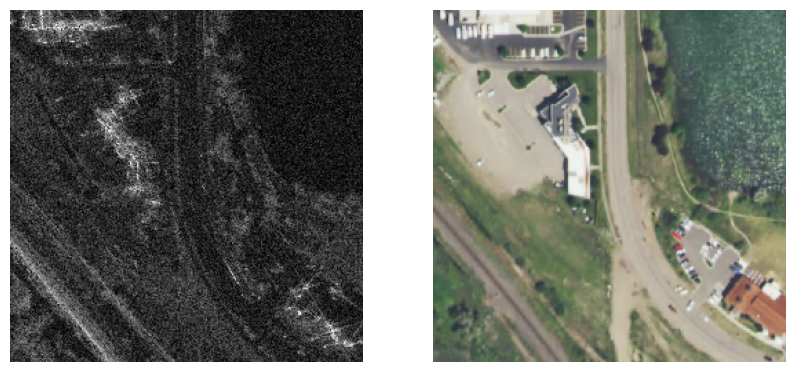

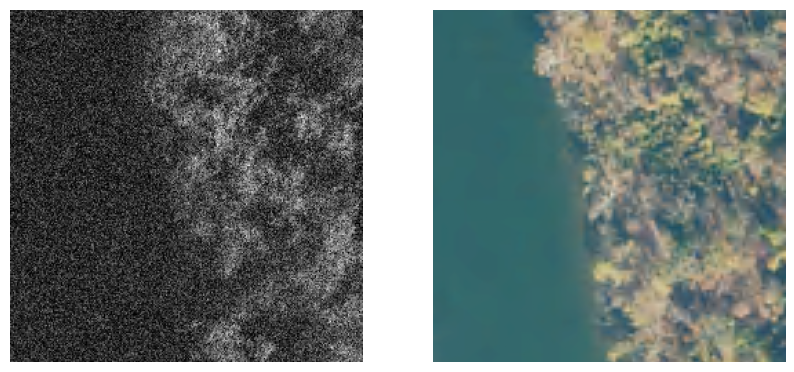

In [9]:
for i in range(5):
    random_idx = np.random.randint(0, len(train_dataset))
    sar, rgb = train_dataset[i]
    plot_image_and_mask(sar, rgb)

# 2. Creating Model

In [10]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from torchvision.utils import save_image
import torch
import torch.nn as nn

norm_layer_G = nn.InstanceNorm2d
norm_layer_D = nn.InstanceNorm2d

# Define the Generator (U-Net) as per the paper
class UNetGenerator(nn.Module):
    def __init__(self, in_channels=1, out_channels=3):
        super(UNetGenerator, self).__init__()

        # Encoder layers (C64-C128-C256-C512-C512-C512-C512-C512)
        self.down1 = self.down_block(in_channels, 64, norm=False)
        self.down2 = self.down_block(64, 128)
        self.down3 = self.down_block(128, 256)
        self.down4 = self.down_block(256, 512)
        self.down5 = self.down_block(512, 512)
        self.down6 = self.down_block(512, 512)
        self.down7 = self.down_block(512, 512)
        self.down8 = self.down_block(512, 512, norm=False)

        # Decoder layers (CD512-CD1024-CD1024-C1024-C1024-C512-C256-C128)
        self.up1 = self.up_block(512, 512, dropout=True) #     512
        self.up2 = self.up_block(1024, 1024, dropout=True) #   512+512=1024
        self.up3 = self.up_block(1536, 1024, dropout=True) #   1024+512=1536
        self.up4 = self.up_block(1536, 1024, dropout=False) #  1024+512=1536
        self.up5 = self.up_block(1536, 1024, dropout=False) #  1024+512=1536
        self.up6 = self.up_block(1280, 512, dropout=False) #   1024+256=1280
        self.up7 = self.up_block(640, 256, dropout=False) #    512+128=640
        self.up8 = self.up_block(320, 128, dropout=False) #    256+64=320

        self.final = nn.Sequential(
            nn.Conv2d(128, out_channels, kernel_size=3, padding=1),
            nn.Tanh()
        )

    def down_block(self, in_channels, out_channels, norm=True):
        layers = [
            nn.Conv2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1, bias=not norm)
        ]
        if norm:
            layers.append(norm_layer_G(out_channels))
        layers.append(nn.LeakyReLU(0.2, inplace=True))
        return nn.Sequential(*layers)

    def up_block(self, in_channels, out_channels, dropout):
        layers = [
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1, bias=False),
            norm_layer_G(out_channels)
        ]
        if dropout:
            layers.append(nn.Dropout(0.5))
        layers.append(nn.ReLU(inplace=True))
        return nn.Sequential(*layers)

    def forward(self, x):
        # Encoder
        d1 = self.down1(x)    # 64
        d2 = self.down2(d1)   # 128
        d3 = self.down3(d2)   # 256
        d4 = self.down4(d3)   # 512
        d5 = self.down5(d4)   # 512
        d6 = self.down6(d5)   # 512
        d7 = self.down7(d6)   # 512
        d8 = self.down8(d7)   # 512

        # Decoder with skip connections
        u1 = self.up1(d8)     # CD512
        u1 = torch.cat([u1, d7], 1)  # 512+512=1024
        u2 = self.up2(u1)     # CD1024
        u2 = torch.cat([u2, d6], 1)  # 1024+512=1536
        u3 = self.up3(u2)     # CD1024
        u3 = torch.cat([u3, d5], 1)  # 1024+512=1536
        u4 = self.up4(u3)     # C1024
        u4 = torch.cat([u4, d4], 1)  # 1024+512=1536
        u5 = self.up5(u4)     # C1024
        u5 = torch.cat([u5, d3], 1)  # 1024+256=1280
        u6 = self.up6(u5)     # C512
        u6 = torch.cat([u6, d2], 1)  # 512+128=640
        u7 = self.up7(u6)     # C256
        u7 = torch.cat([u7, d1], 1)  # 256+64=320
        u8 = self.up8(u7)     # C128

        return self.final(u8)

# Define the Discriminator (70x70 PatchGAN) as per the paper
class Discriminator(nn.Module):
    def __init__(self, in_channels=4):
        super(Discriminator, self).__init__()

        self.model = nn.Sequential(
            # C64 (no BatchNorm)
            nn.Conv2d(in_channels, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            
            # C128
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            norm_layer_D(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            # C256
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            norm_layer_D(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            # C512
            nn.Conv2d(256, 512, kernel_size=4, stride=1, padding=1),
            norm_layer_D(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            # Final convolution
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1),
            nn.Sigmoid()
        )

    def forward(self, sar, rgb):
        x = torch.cat([sar, rgb], 1)
        return self.model(x)

In [11]:
generator = UNetGenerator().to(device)
discriminator = Discriminator().to(device)

In [12]:
#x = torch.randn(4, 1, 256, 256).to(device)
#y=generator(x)
#y.shape

In [13]:
#x = torch.randn(4, 1, 256, 256).to(device)
#y = torch.randn(4, 3, 256, 256).to(device)
#z = discriminator(sar=x, rgb=y)
#z.shape, z.size(2), z.size(3)

# 3. Train Model

In [14]:
def test_step(model, sar, rgb, show_plot=True, epoch=None):
    """
    Performs the forward pass of the cVAE model during evaluation.
    
    Args:
        model: The cVAE model.
        sar: SAR images [B, 1, H, W].
        rgb: Target RGB images [B, 3, H, W].
        
    Returns:
        recon_rgb: The reconstructed RGB images.
    """
    model.eval()
    # Set only dropout layers back to training mode
    for module in model.modules():
        if isinstance(module, nn.Dropout):
            module.train()
        
    with torch.inference_mode():
        recon_rgb = model(sar)
    recon_rgb_norm = denormalize_rgb(recon_rgb.cpu())
    if show_plot:
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 3, 1)
        plt.axis('off')
        plt.title('SAR' + (' (Epoch {})'.format(epoch) if epoch!=None else ''))
        plt.imshow(denormalize_sar(sar.cpu()).squeeze(), cmap='gray')

        plt.subplot(1, 3, 2)
        plt.axis('off')
        plt.title('Reconstructed RGB' + (' (Epoch {})'.format(epoch) if epoch!=None else ''))
        plt.imshow(recon_rgb_norm.squeeze().permute(1, 2, 0))

        plt.subplot(1, 3, 3)
        plt.axis('off')
        plt.title('Target RGB' + (' (Epoch {})'.format(epoch) if epoch!=None else ''))
        plt.imshow(denormalize_rgb(rgb.cpu()).squeeze().permute(1, 2, 0))

        plt.show()

In [15]:
from tqdm import tqdm
import numpy as np  # Make sure to import numpy if not already
def train():
    random_idx = np.random.randint(0, len(train_dataset))
    random_sar, random_rgb = train_dataset[random_idx]
    random_sar = random_sar.unsqueeze(0).to(device)
    
    # Initial test step before training
    test_step(generator, random_sar, random_rgb, show_plot=True, epoch=0)
    
    for epoch in range(epochs):
        epoch_D_loss = 0.0
        epoch_G_loss = 0.0
        for i, (sar, real_rgb) in tqdm(enumerate(train_loader), total=len(train_loader)):
            sar = sar.to(device)
            real_rgb = real_rgb.to(device)
            
            # Train Discriminator
            optimizer_D.zero_grad()
            
            # Generate fake RGB
            fake_rgb = generator(sar)
            
            # Real loss
            disc_real_out = discriminator(sar, real_rgb)
            real_labels = torch.ones((sar.size(0), 1, disc_real_out.size(2), disc_real_out.size(3))).to(device)  # PatchGAN output size
            real_loss = loss_fn_GAN(disc_real_out, real_labels)
            
            # Fake loss
            disc_fake_out = discriminator(sar, fake_rgb.detach())
            fake_labels = torch.zeros((sar.size(0), 1, disc_fake_out.size(2), disc_fake_out.size(3))).to(device)
            fake_loss = loss_fn_GAN(disc_fake_out, fake_labels)
            
            d_loss = (real_loss + fake_loss) * 0.5
            d_loss.backward()
            optimizer_D.step()
            
            # Train Generator
            optimizer_G.zero_grad()
            
            # GAN loss
            g_loss_gan = loss_fn_GAN(discriminator(sar, fake_rgb), real_labels)
            # L1 loss
            g_loss_l1 = loss_fn_L1(fake_rgb, real_rgb)
            
            g_loss = g_loss_gan + lambda_l1 * g_loss_l1
            g_loss.backward()
            optimizer_G.step()

            epoch_D_loss += d_loss.item()
            epoch_G_loss += g_loss.item()
                
        # Show
        print(f"[Epoch {epoch+1}/{epochs}] | "
              f"D_loss: {epoch_D_loss/len(train_loader):.4f} G_loss: {epoch_G_loss/len(train_loader):.4f}")
        test_step(generator, random_sar, random_rgb, show_plot=True, epoch=epoch+1)

In [16]:
from datetime import datetime

BATCH_SIZE = 8
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

loss_fn_GAN = nn.BCELoss()
loss_fn_L1 = nn.L1Loss()

lr = 0.0002 # 2e-4
beta1 = 0.5
lambda_l1 = 100.0

optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))

epochs=10

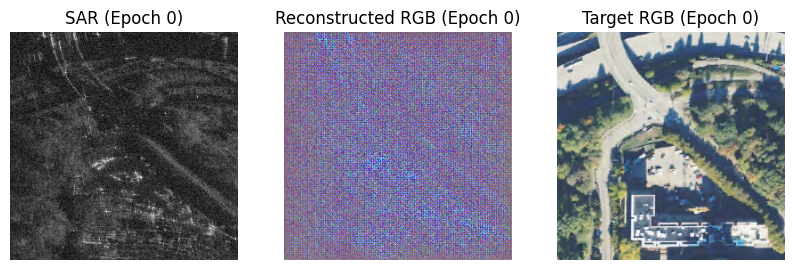

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [07:19<00:00,  1.23it/s]


[Epoch 1/10] | D_loss: 0.3579 G_loss: 33.5379


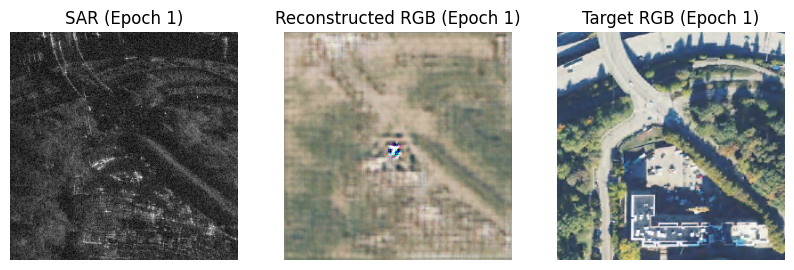

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:41<00:00,  1.59it/s]


[Epoch 2/10] | D_loss: 0.3201 G_loss: 32.8892


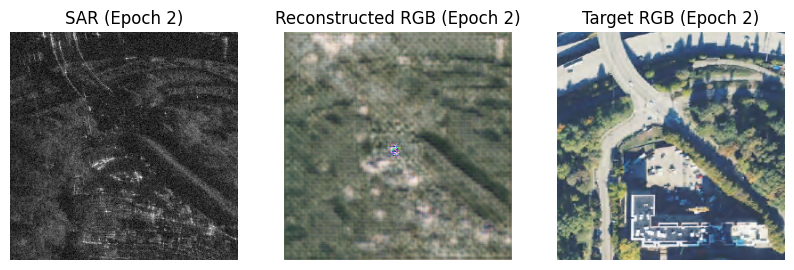

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:39<00:00,  1.60it/s]


[Epoch 3/10] | D_loss: 0.3128 G_loss: 32.1952


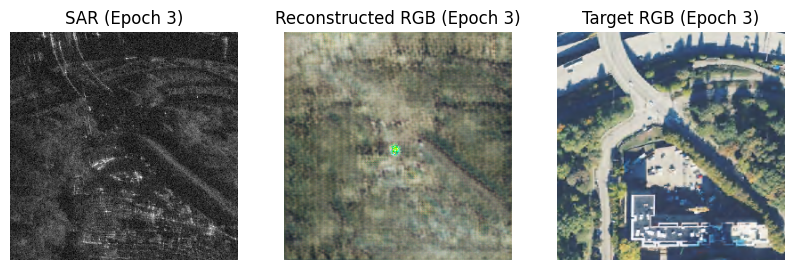

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:45<00:00,  1.57it/s]


[Epoch 4/10] | D_loss: 0.2969 G_loss: 31.8502


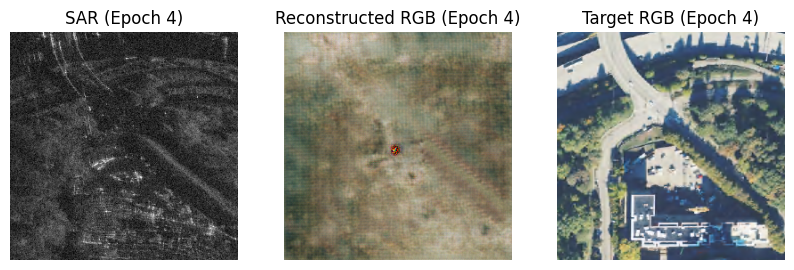

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:45<00:00,  1.57it/s]


[Epoch 5/10] | D_loss: 0.3121 G_loss: 31.5971


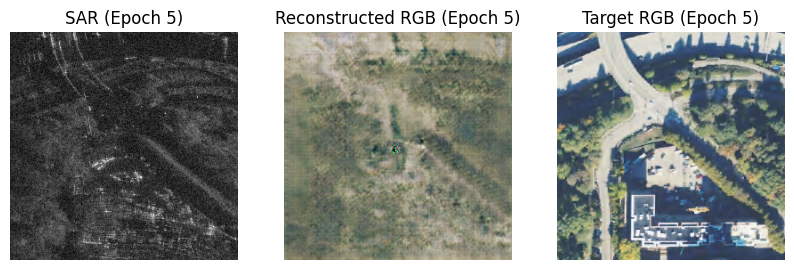

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:35<00:00,  1.62it/s]


[Epoch 6/10] | D_loss: 0.3123 G_loss: 31.1431


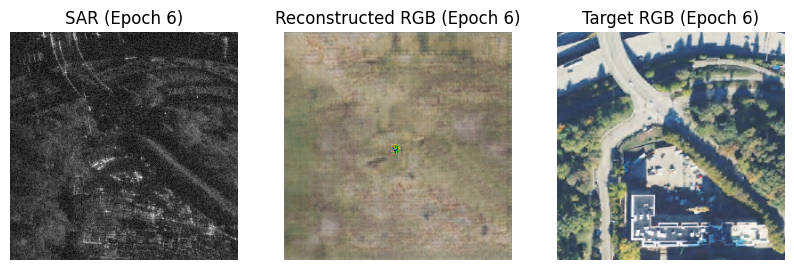

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]


[Epoch 7/10] | D_loss: 0.3043 G_loss: 30.6888


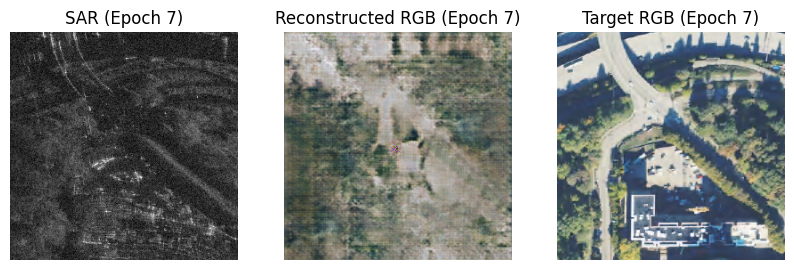

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:38<00:00,  1.60it/s]


[Epoch 8/10] | D_loss: 0.3120 G_loss: 30.2377


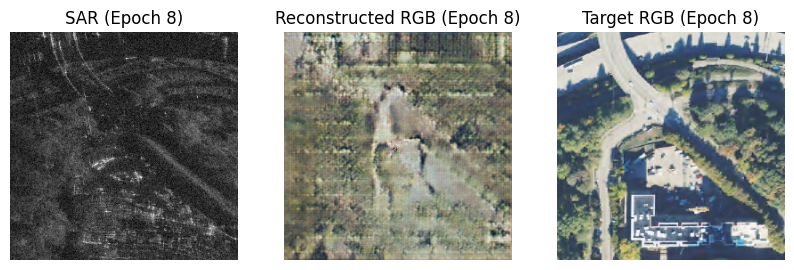

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]

[Epoch 9/10] | D_loss: 0.3121 G_loss: 29.4558


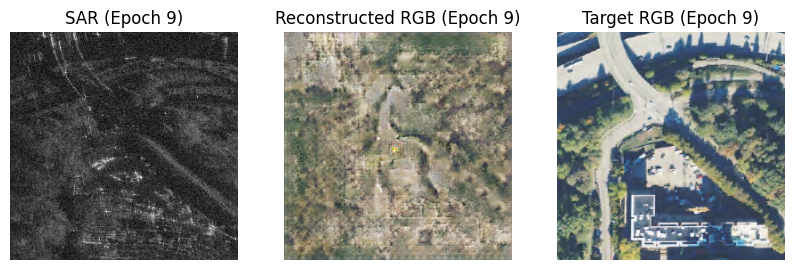

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]


[Epoch 10/10] | D_loss: 0.3111 G_loss: 28.5817


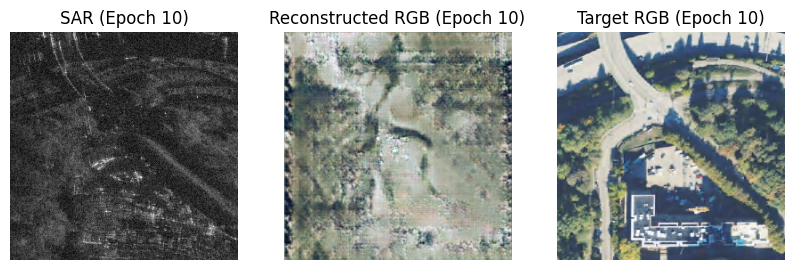

In [17]:
train()

# 4. Visualize Results

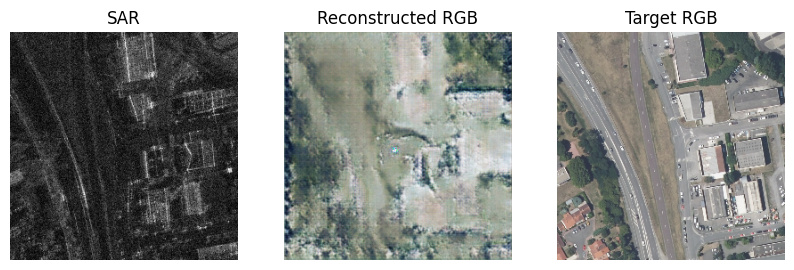

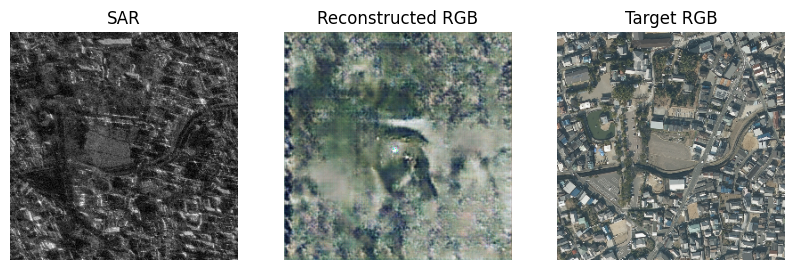

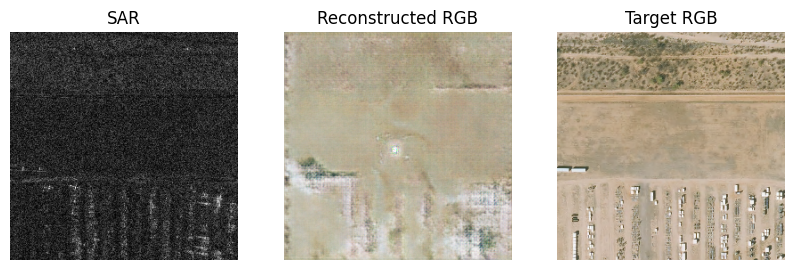

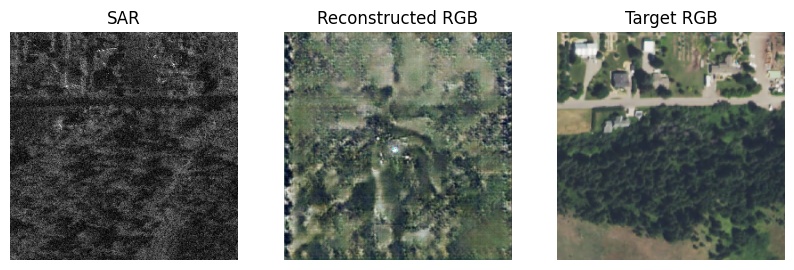

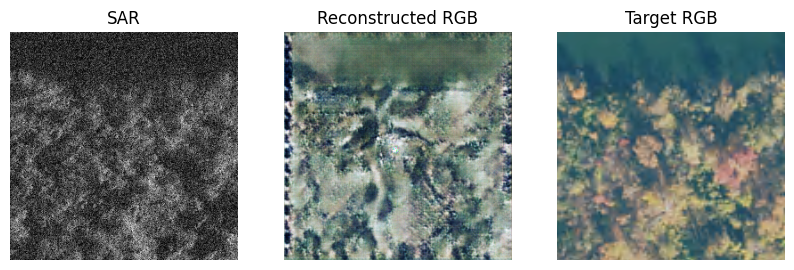

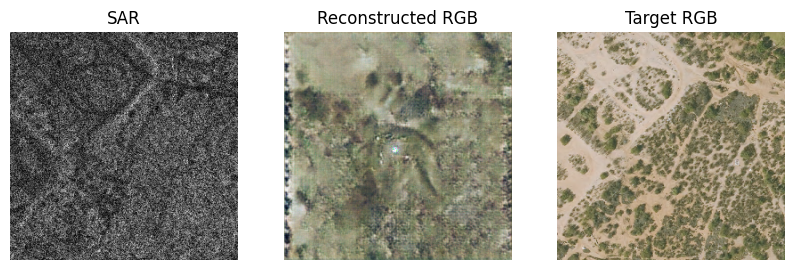

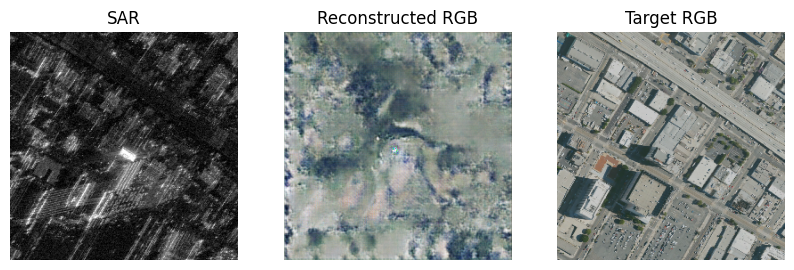

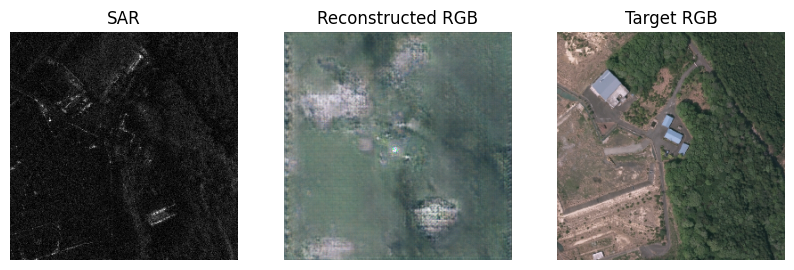

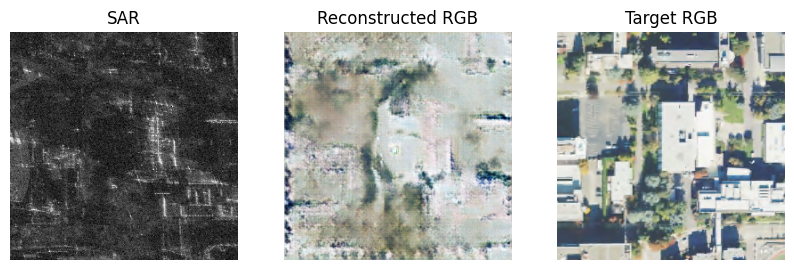

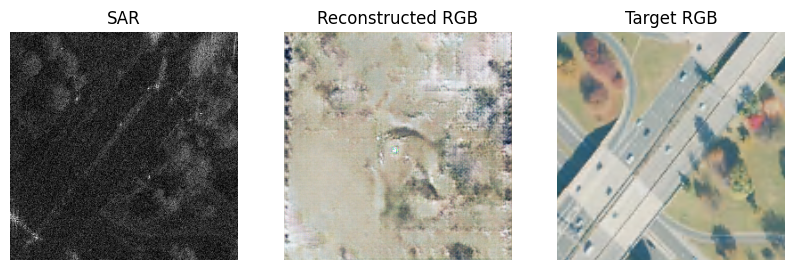

In [18]:
for i in range(10):
    random_idx = np.random.randint(0, len(train_dataset))
    random_sar, random_rgb = train_dataset[random_idx]
    random_sar = random_sar.unsqueeze(0).to(device)
    
    # Initial test step before training
    test_step(generator, random_sar, random_rgb, show_plot=True)

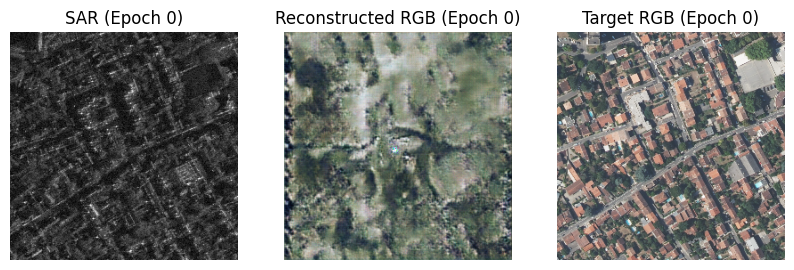

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]


[Epoch 1/10] | D_loss: 0.3095 G_loss: 27.7796


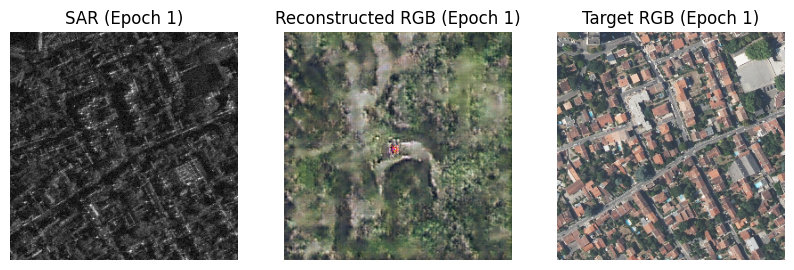

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]


[Epoch 2/10] | D_loss: 0.3034 G_loss: 27.1961


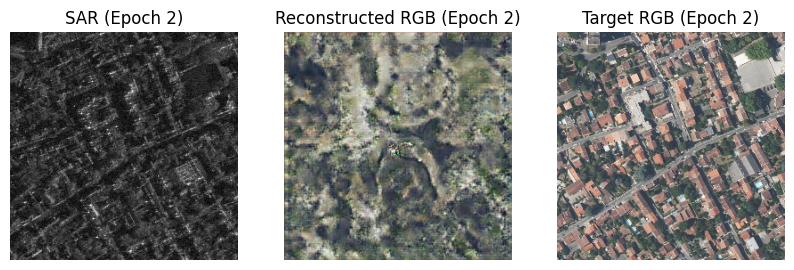

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]


[Epoch 3/10] | D_loss: 0.3083 G_loss: 26.5919


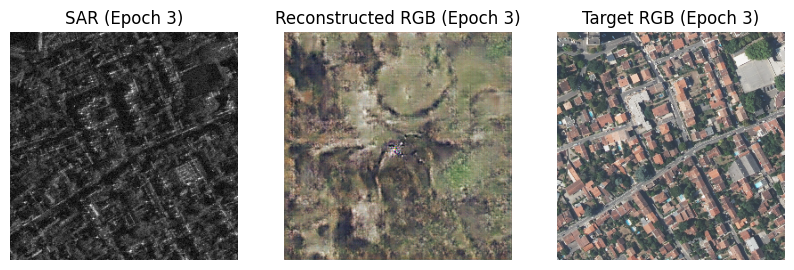

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]


[Epoch 4/10] | D_loss: 0.3031 G_loss: 26.1766


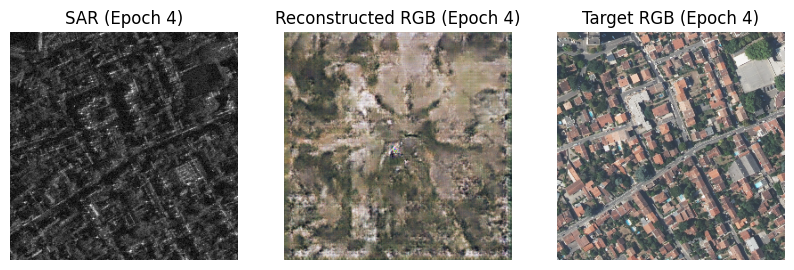

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]


[Epoch 5/10] | D_loss: 0.3132 G_loss: 25.9165


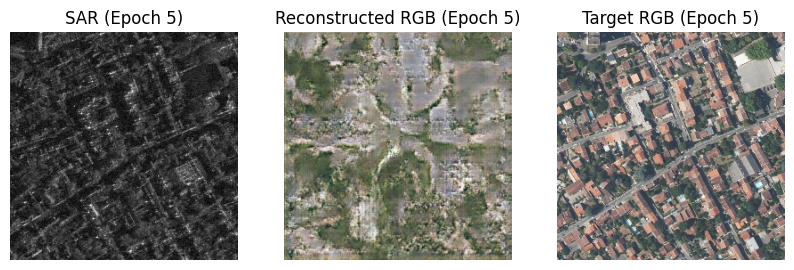

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:35<00:00,  1.62it/s]


[Epoch 6/10] | D_loss: 0.3194 G_loss: 25.5890


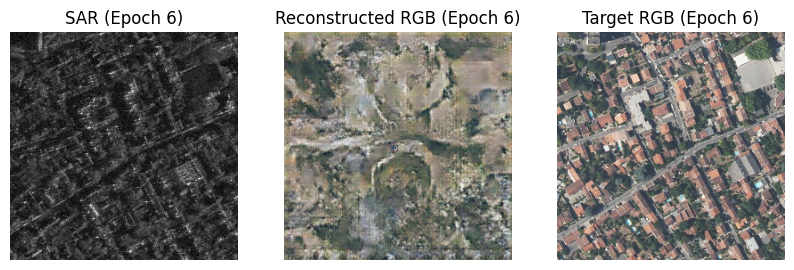

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:37<00:00,  1.61it/s]


[Epoch 7/10] | D_loss: 0.3215 G_loss: 25.2744


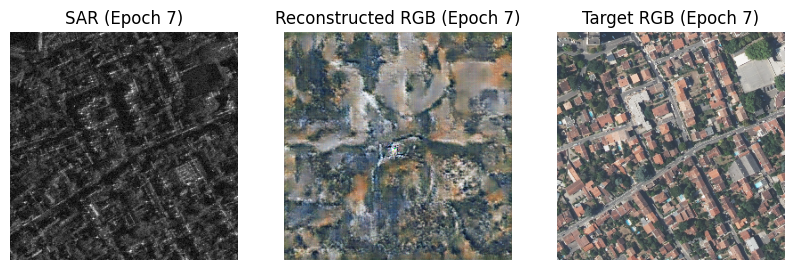

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:37<00:00,  1.61it/s]


[Epoch 8/10] | D_loss: 0.3310 G_loss: 24.9842


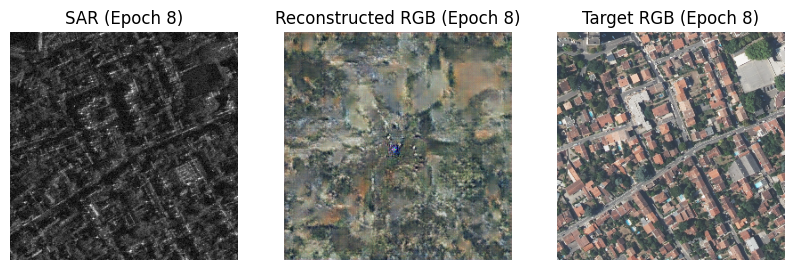

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:36<00:00,  1.61it/s]


[Epoch 9/10] | D_loss: 0.3308 G_loss: 24.7223


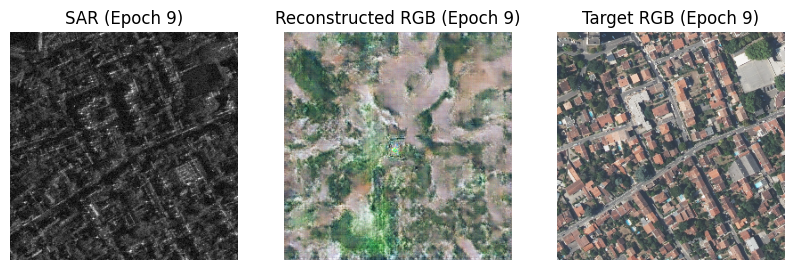

100%|████████████████████████████████████████████████████████████████████████████████| 542/542 [05:37<00:00,  1.61it/s]


[Epoch 10/10] | D_loss: 0.3338 G_loss: 24.4164


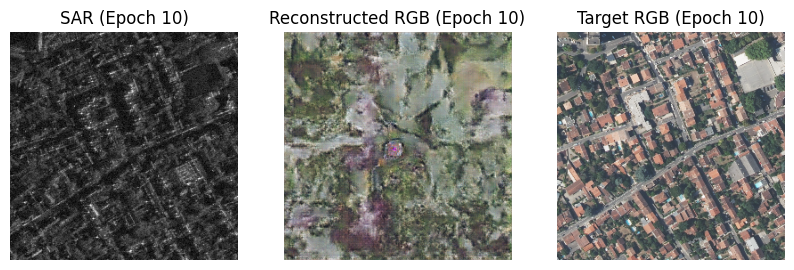

In [19]:
train()

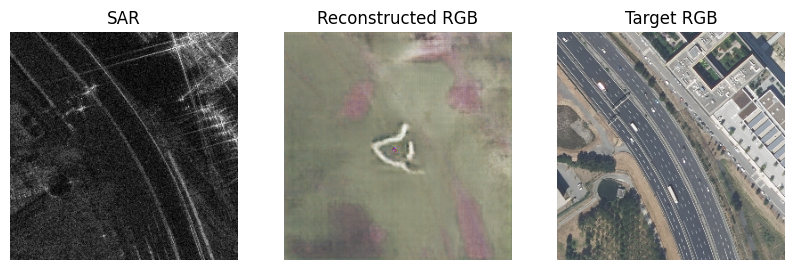

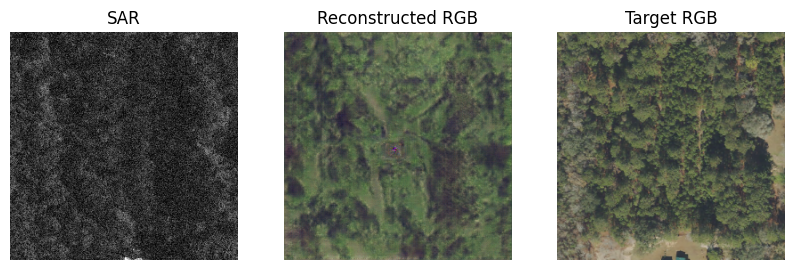

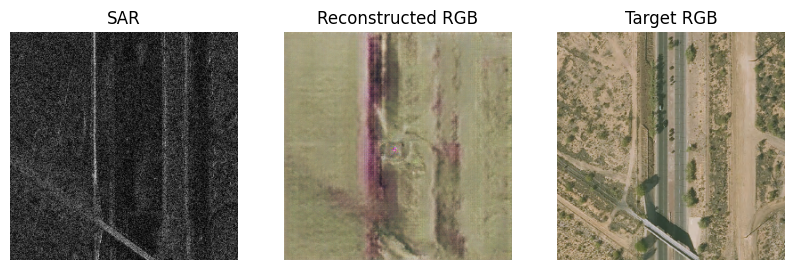

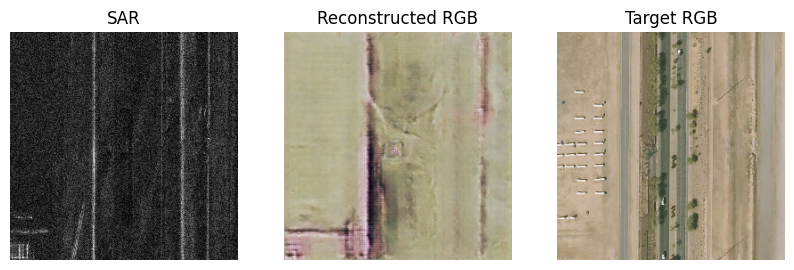

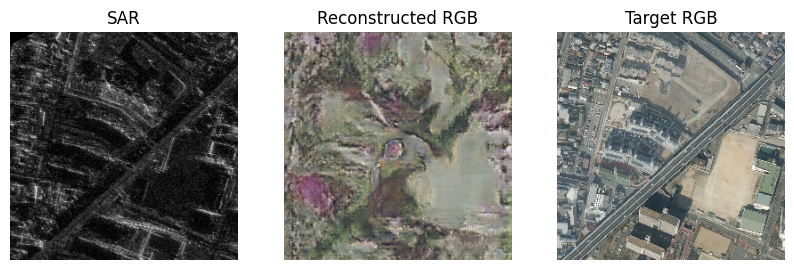

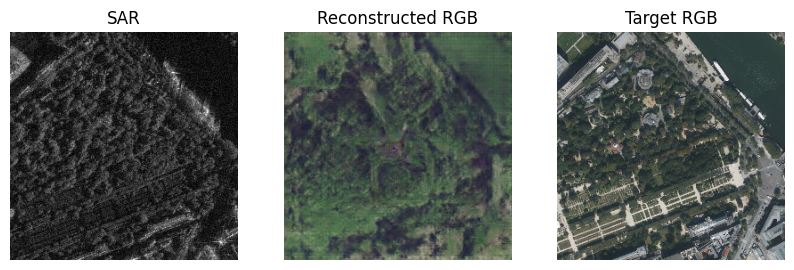

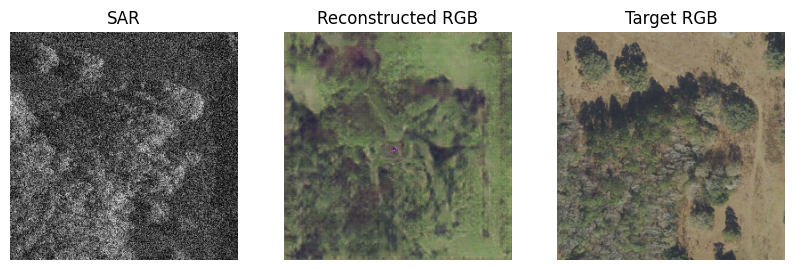

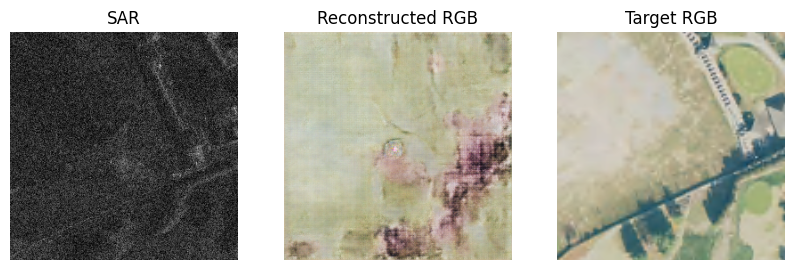

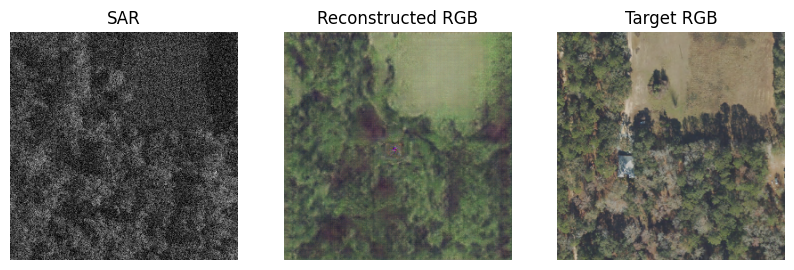

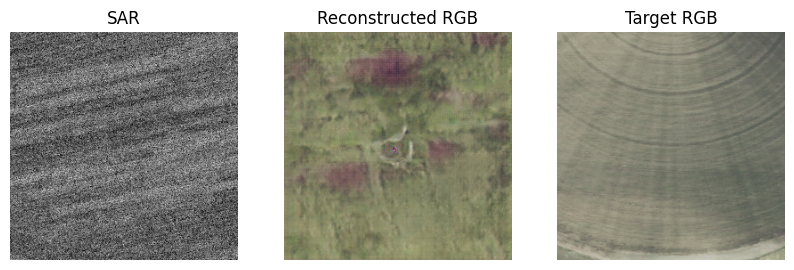

In [20]:
for i in range(10):
    random_idx = np.random.randint(0, len(train_dataset))
    random_sar, random_rgb = train_dataset[random_idx]
    random_sar = random_sar.unsqueeze(0).to(device)
    
    test_step(generator, random_sar, random_rgb, show_plot=True)

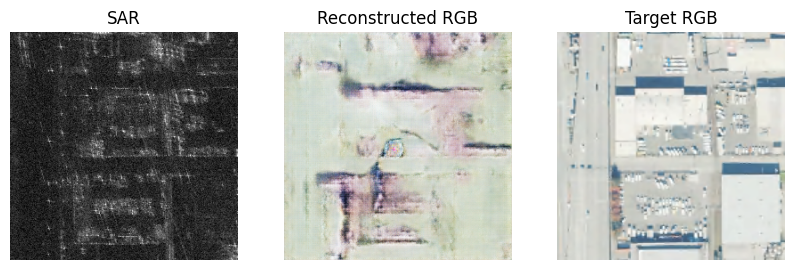

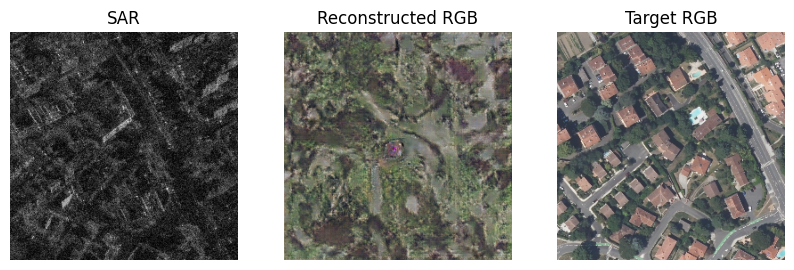

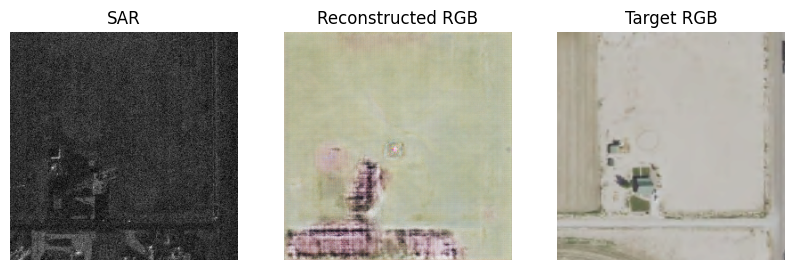

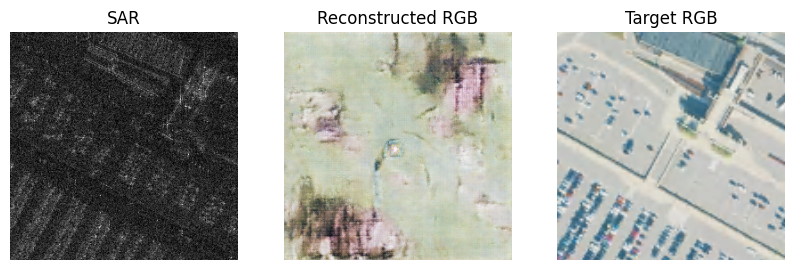

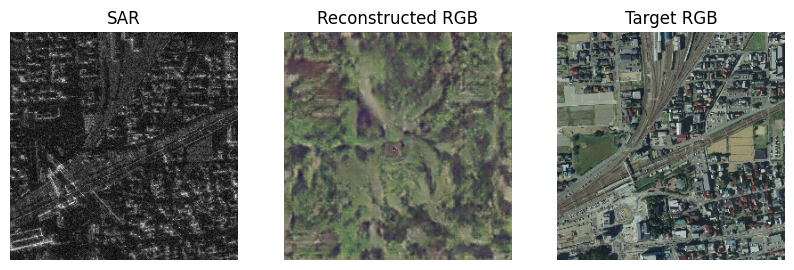

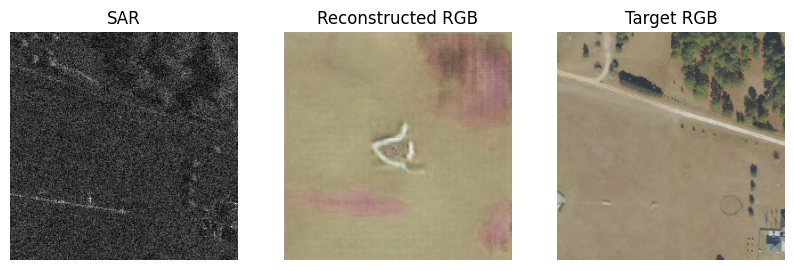

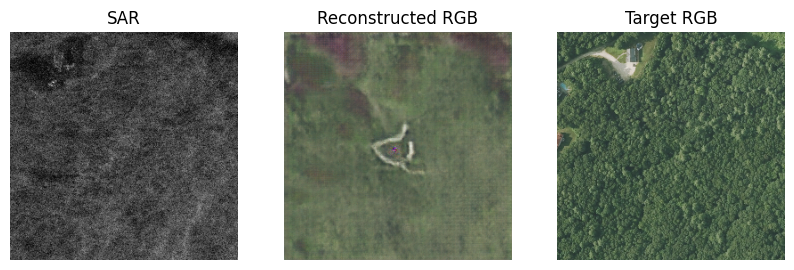

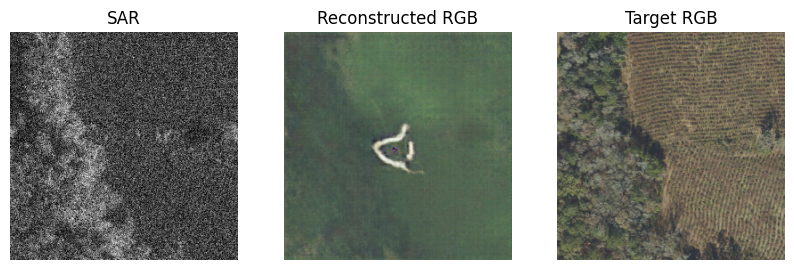

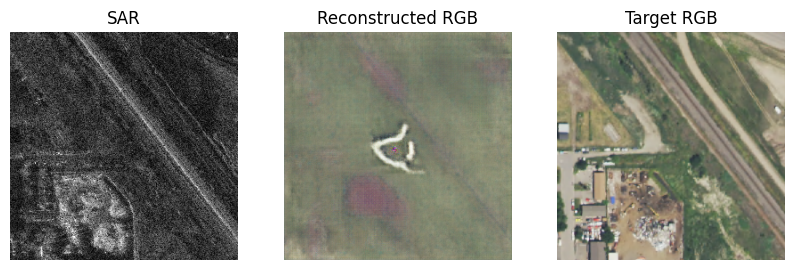

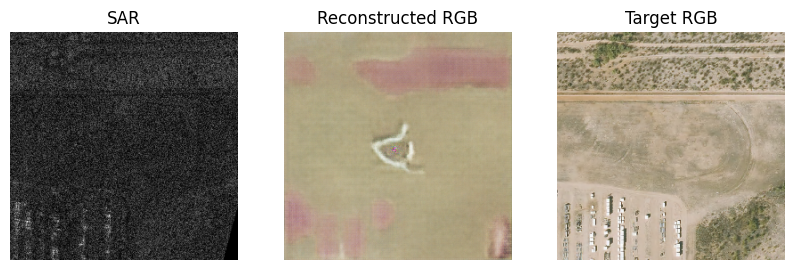

In [21]:
for i in range(10):
    random_idx = np.random.randint(0, len(train_dataset))
    random_sar, random_rgb = train_dataset[random_idx]
    random_sar = random_sar.unsqueeze(0).to(device)
    
    test_step(generator, random_sar, random_rgb, show_plot=True)

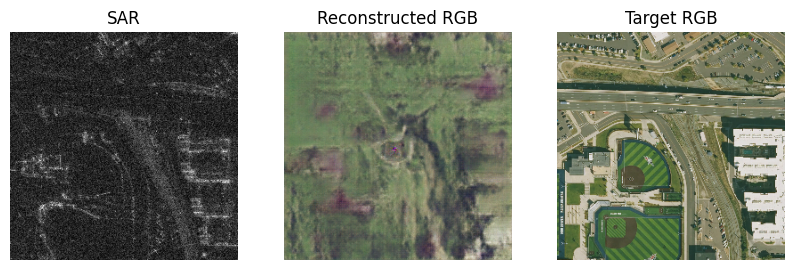

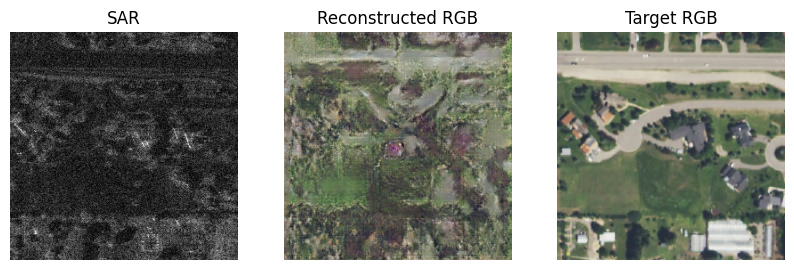

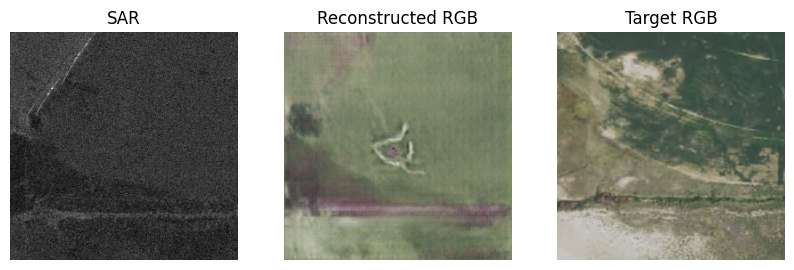

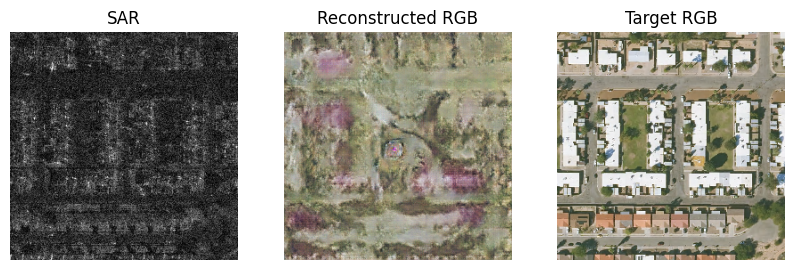

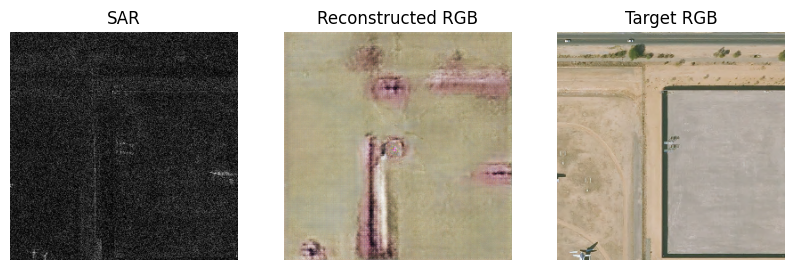

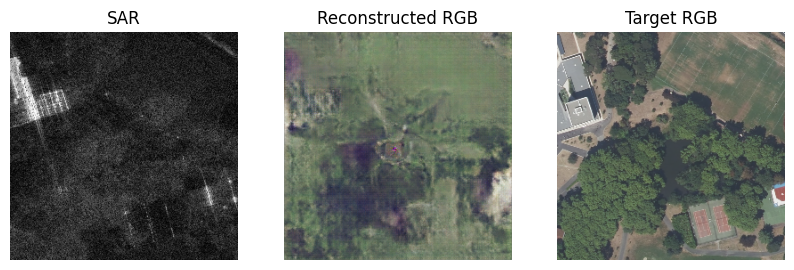

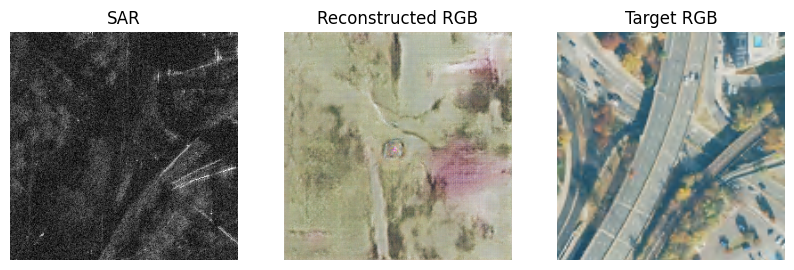

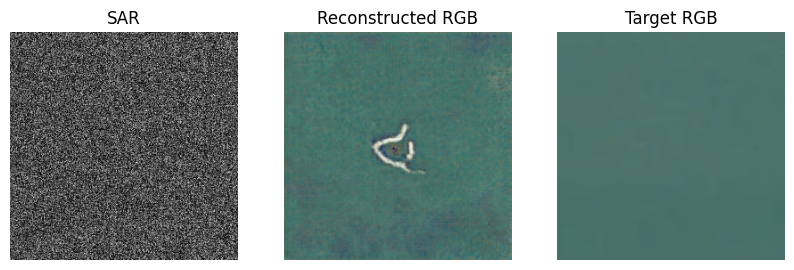

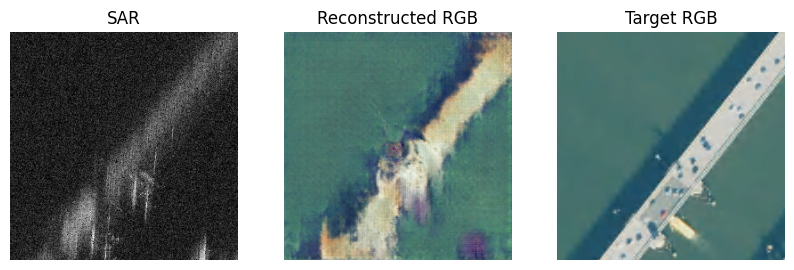

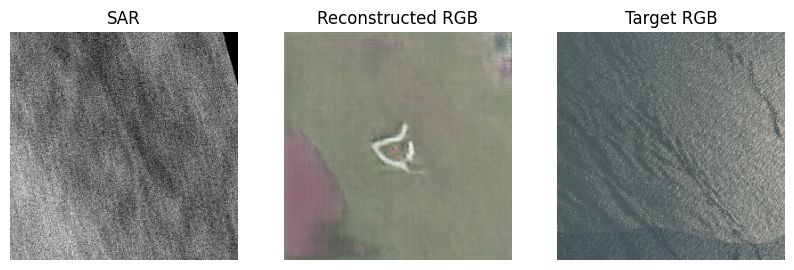

In [23]:
for i in range(10):
    random_idx = np.random.randint(0, len(train_dataset))
    random_sar, random_rgb = train_dataset[random_idx]
    random_sar = random_sar.unsqueeze(0).to(device)
    
    test_step(generator, random_sar, random_rgb, show_plot=True)

In [22]:
torch.save(generator, "pix2pix_v2_generator.pth")
torch.save(discriminator, "pix2pix_v2_discriminator.pth")